In [33]:
import math
import geopandas
import shapely
import shapefile
import plotly
import numpy as np 
import pandas as pd 
import plotly.express as ex
import plotly.graph_objects as go
import plotly.offline as pyo
from plotly.figure_factory._county_choropleth import create_choropleth
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

In [58]:
pd.set_option('display.max_columns', None)

In [59]:
vac = pd.read_csv('../cleaned_data/vac_rate.csv')

hes = pd.read_csv('../cleaned_data/vaccine_hest.csv')

In [4]:
vac.head()

,fips,recip_county,recip_state,series_complete_pop_pct,series_complete_yes,series_complete_12plus,series_complete_12pluspop_pct,series_complete_18plus,series_complete_18pluspop_pct,series_complete_65plus,series_complete_65pluspop_pct,completeness_pct,administered_dose1_recip,administered_dose1_pop_pct,administered_dose1_recip_12plus,administered_dose1_recip_12pluspop_pct,administered_dose1_recip_18plus,administered_dose1_recip_18pluspop_pct,administered_dose1_recip_65plus,administered_dose1_recip_65pluspop_pct,svi_ctgy,series_complete_pop_pct_svi,series_complete_12pluspop_pct_svi,series_complete_18pluspop_pct_svi,series_complete_65pluspop_pct_svi,metro_status,series_complete_pop_pct_ur_equity,series_complete_12pluspop_pct_ur_equity,series_complete_18pluspop_pct_ur_equity,series_complete_65pluspop_pct_ur_equity,administered_dose1_recip_5plus,administered_dose1_recip_5pluspop_pct,series_complete_5plus,series_complete_5pluspop_pct
0,13007,Baker County,GA,35.7,1085,1078.0,40.7,1017,41.6,314,43.7,59.6,1238.0,40.8,1225.0,46.2,1158.0,47.3,346.0,48.1,C,10.0,11.0,11.0,10.0,Metro,2.0,3.0,3.0,2.0,1238.0,43.2,1085.0,37.9
1,6083,Santa Barbara County,CA,65.5,292460,287585.0,75.6,266675,76.6,62612,89.3,97.5,337180.0,75.5,328565.0,86.4,304599.0,87.5,71297.0,95.0,C,12.0,12.0,12.0,12.0,Metro,4.0,4.0,4.0,4.0,337148.0,80.4,292455.0,69.8
2,36051,Livingston County,NY,56.8,35726,35078.0,62.7,32924,63.5,10251,88.9,97.6,38175.0,60.7,37237.0,66.6,34935.0,67.4,10921.0,94.7,B,8.0,8.0,8.0,8.0,Metro,4.0,4.0,4.0,4.0,38174.0,63.4,35726.0,59.3
3,34005,Burlington County,NJ,70.1,312046,305019.0,78.8,285012,80.7,69495,89.8,93.8,361996.0,81.3,350386.0,90.5,327961.0,92.9,80217.0,95.0,A,4.0,4.0,4.0,4.0,Metro,4.0,4.0,4.0,4.0,361967.0,85.6,312041.0,73.8
4,1021,Chilton County,AL,34.0,15086,15032.0,40.1,14277,42.2,4891,64.4,92.7,18410.0,41.4,18254.0,48.7,17335.0,51.2,5658.0,74.4,D,14.0,15.0,15.0,15.0,Metro,2.0,3.0,3.0,3.0,18409.0,44.1,15086.0,36.2


In [5]:
hes.head()

,fips_code,state,estimated_hesitant,estimated_hesitant_or_unsure,estimated_strongly_hesitant,social_vulnerability_index_(svi),svi_category,cvac_level_of_concern_for_vaccination_rollout,cvac_level_of_concern,percent_adults_fully_vaccinated_against_covid-19_(as_of_6/10/21),percent_hispanic,percent_non-hispanic_american_indian/alaska_native,percent_non-hispanic_asian,percent_non-hispanic_black,percent_non-hispanic_native_hawaiian/pacific_islander,percent_non-hispanic_white,state_code,name_of_county
0,1123,ALABAMA,0.1806,0.2400,0.1383,0.89,Very High Vulnerability,0.64,High Concern,0.305,0.0242,0.0022,0.0036,0.2697,0.0000,0.6887,AL,Tallapoosa County
1,1121,ALABAMA,0.1783,0.2350,0.1368,0.87,Very High Vulnerability,0.84,Very High Concern,0.265,0.0229,0.0043,0.0061,0.3237,0.0003,0.6263,AL,Talladega County
2,1131,ALABAMA,0.1735,0.2357,0.1337,0.93,Very High Vulnerability,0.94,Very High Concern,0.394,0.0053,0.0009,0.0003,0.6938,0.0000,0.2684,AL,Wilcox County
3,1129,ALABAMA,0.1735,0.2357,0.1337,0.73,High Vulnerability,0.82,Very High Concern,0.308,0.0146,0.0731,0.0025,0.2354,0.0000,0.6495,AL,Washington County
4,1133,ALABAMA,0.1805,0.2313,0.1379,0.70,High Vulnerability,0.80,High Concern,0.163,0.0315,0.0034,0.0016,0.0073,0.0005,0.9370,AL,Winston County


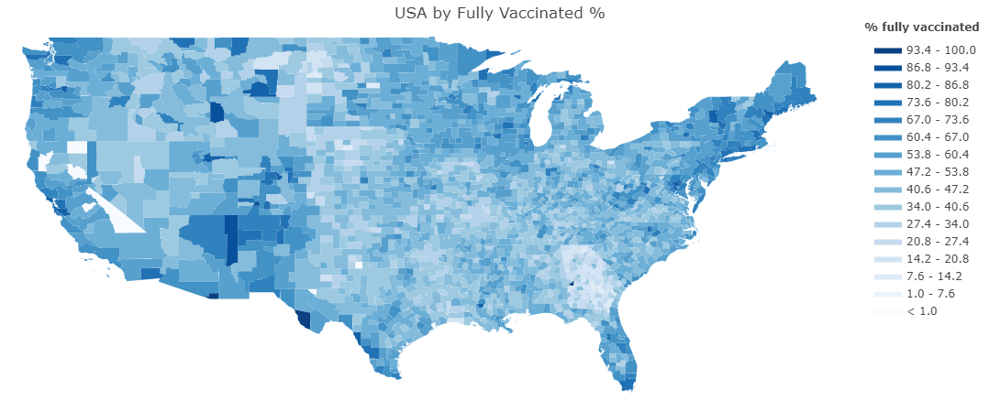

In [23]:
colorscale = ["#f7fbff","#ebf3fb","#deebf7","#d2e3f3","#c6dbef","#b3d2e9","#9ecae1",
              "#85bcdb","#6baed6","#57a0ce","#4292c6","#3082be","#2171b5","#1361a9",
              "#08519c","#0b4083","#08306b"]
endpts = list(np.linspace(1, 100, len(colorscale) - 1))
fips = vac['fips'].tolist()
values = vac['series_complete_pop_pct'].tolist()

fig = create_choropleth(
    fips=fips, values=values,
    binning_endpoints=endpts,
    colorscale=colorscale,
    show_state_data=False,
    show_hover=True, centroid_marker={'opacity': 0},
    asp=2.9, title='USA by Fully Vaccinated %',
    legend_title='% fully vaccinated'
)

fig.layout.template = None
fig.show()

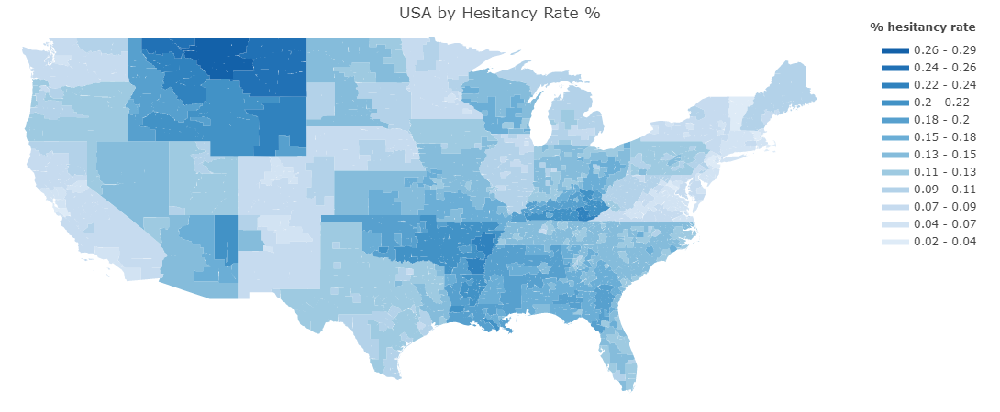

In [12]:
colorscale = ["#f7fbff","#ebf3fb","#deebf7","#d2e3f3","#c6dbef","#b3d2e9","#9ecae1",
              "#85bcdb","#6baed6","#57a0ce","#4292c6","#3082be","#2171b5","#1361a9",
              "#08519c","#0b4083","#08306b"]
endpts = list(np.linspace(0, .33,len(colorscale) - 1))
fips = hes['fips_code'].tolist()
values = hes['estimated_hesitant'].tolist()

fig = create_choropleth(
    fips=fips, values=values,
    binning_endpoints=endpts,
    colorscale=colorscale,
    show_state_data=False,
    show_hover=True, centroid_marker={'opacity': 0},
    asp=2.9, title='USA by Hesitancy Rate %',
    legend_title='% hesitancy rate '
)

fig.layout.template = None
fig.show()

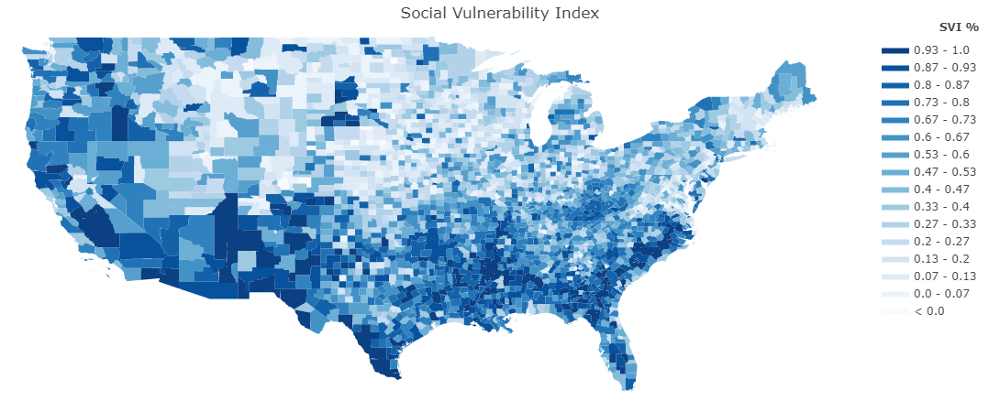

In [14]:
colorscale = ["#f7fbff","#ebf3fb","#deebf7","#d2e3f3","#c6dbef","#b3d2e9","#9ecae1",
              "#85bcdb","#6baed6","#57a0ce","#4292c6","#3082be","#2171b5","#1361a9",
              "#08519c","#0b4083","#08306b"]
endpts = list(np.linspace(0, 1,len(colorscale) - 1))
fips = hes['fips_code'].tolist()
values = hes['social_vulnerability_index_(svi)'].tolist()

fig = create_choropleth(
    fips=fips, values=values,
    binning_endpoints=endpts,
    colorscale=colorscale,
    show_state_data=False,
    show_hover=True, centroid_marker={'opacity': 0},
    asp=2.9, title='Social Vulnerability Index',
    legend_title='SVI %'
)

fig.layout.template = None
fig.show()

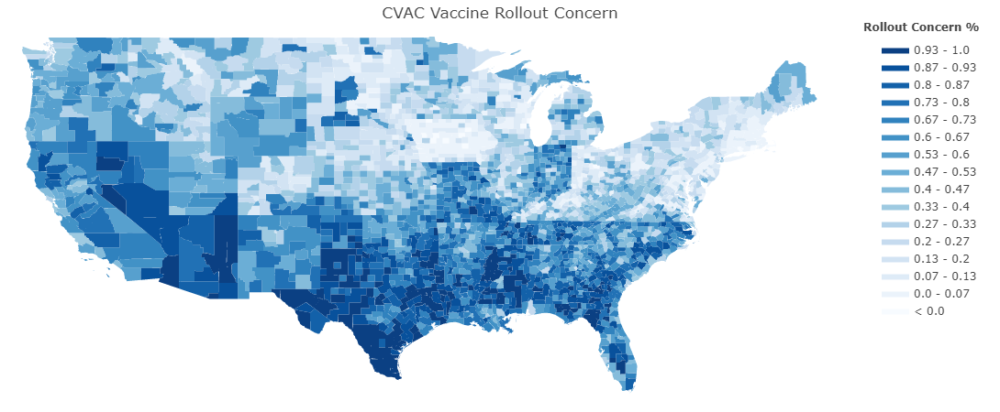

In [15]:
colorscale = ["#f7fbff","#ebf3fb","#deebf7","#d2e3f3","#c6dbef","#b3d2e9","#9ecae1",
              "#85bcdb","#6baed6","#57a0ce","#4292c6","#3082be","#2171b5","#1361a9",
              "#08519c","#0b4083","#08306b"]
endpts = list(np.linspace(0, 1,len(colorscale) - 1))
fips = hes['fips_code'].tolist()
values = hes['cvac_level_of_concern_for_vaccination_rollout'].tolist()

fig = create_choropleth(
    fips=fips, values=values,
    binning_endpoints=endpts,
    colorscale=colorscale,
    show_state_data=False,
    show_hover=True, centroid_marker={'opacity': 0},
    asp=2.9, title='CVAC Vaccine Rollout Concern',
    legend_title='Rollout Concern %'
)

fig.layout.template = None
fig.show()

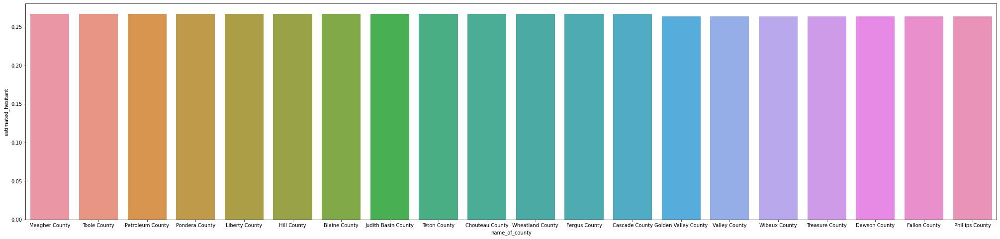

In [72]:
hes_most = hes.sort_values(by='estimated_hesitant', ascending=False).head(20)

plt.figure(figsize = (35,8))

ax = sns.barplot(x = "name_of_county", 
                 y = "estimated_hesitant",
                data = hes_most)

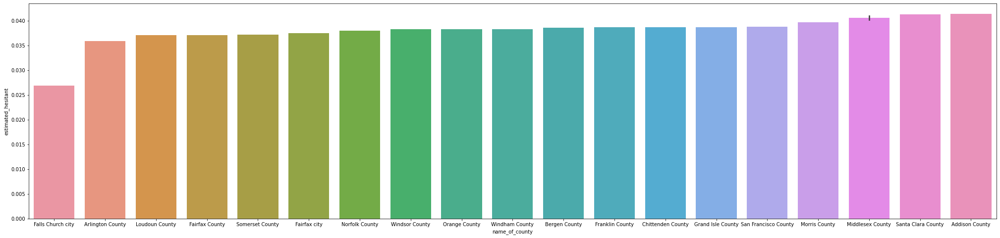

In [74]:
hes_least = hes.sort_values(by='estimated_hesitant', ascending=True).head(20)

plt.figure(figsize = (35,8))

ax = sns.barplot(x = "name_of_county", 
                 y = "estimated_hesitant",
                data = hes_least)

In [84]:
hes_least

,fips_code,state,estimated_hesitant,estimated_hesitant_or_unsure,estimated_strongly_hesitant,social_vulnerability_index_(svi),svi_category,cvac_level_of_concern_for_vaccination_rollout,cvac_level_of_concern,percent_adults_fully_vaccinated_against_covid-19_(as_of_6/10/21),percent_hispanic,percent_non-hispanic_american_indian/alaska_native,percent_non-hispanic_asian,percent_non-hispanic_black,percent_non-hispanic_native_hawaiian/pacific_islander,percent_non-hispanic_white,state_code,name_of_county
2987,51610,VIRGINIA,0.0269,0.0499,0.0186,0.14,Very Low Vulnerability,0.00,Very Low Concern,0.071,0.1067,0.0000,0.0988,0.0464,0.0000,0.7174,VA,Falls Church city
2785,51013,VIRGINIA,0.0359,0.0722,0.0239,0.14,Very Low Vulnerability,0.14,Very Low Concern,0.394,0.1558,0.0024,0.1020,0.0888,0.0009,0.6149,VA,Arlington County
213,51107,VIRGINIA,0.0371,0.0718,0.0258,0.09,Very Low Vulnerability,0.05,Very Low Concern,0.489,0.1362,0.0022,0.1846,0.0726,0.0008,0.5611,VA,Loudoun County
2976,51059,VIRGINIA,0.0371,0.0743,0.0256,0.19,Very Low Vulnerability,0.03,Very Low Concern,0.541,0.1633,0.0013,0.1907,0.0948,0.0006,0.5074,VA,Fairfax County
1926,34035,NEW JERSEY,0.0372,0.0799,0.0254,0.10,Very Low Vulnerability,0.03,Very Low Concern,0.648,0.1465,0.0012,0.1759,0.0923,0.0001,0.5629,NJ,Somerset County
218,51600,VIRGINIA,0.0375,0.0755,0.0264,0.24,Low Vulnerability,0.02,Very Low Concern,0.073,0.1718,0.0000,0.1717,0.0492,0.0000,0.5622,VA,Fairfax city
1476,25021,MASSACHUSETTS,0.0380,0.0552,0.0281,0.21,Low Vulnerability,0.01,Very Low Concern,0.701,0.0453,0.0011,0.1102,0.0672,0.0004,0.7491,MA,Norfolk County
2872,50027,VERMONT,0.0383,0.0864,0.0207,0.13,Very Low Vulnerability,0.09,Very Low Concern,0.483,0.0168,0.0016,0.0087,0.0071,0.0004,0.9465,VT,Windsor County
2779,50017,VERMONT,0.0383,0.0864,0.0207,0.17,Very Low Vulnerability,0.14,Very Low Concern,0.482,0.0134,0.0036,0.0023,0.0069,0.0010,0.9557,VT,Orange County
2773,50025,VERMONT,0.0383,0.0864,0.0207,0.31,Low Vulnerability,0.31,Low Concern,0.559,0.0233,0.0027,0.0101,0.0109,0.0003,0.9309,VT,Windham County


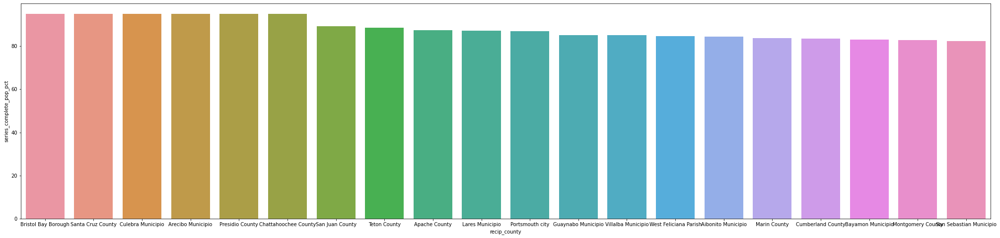

In [78]:
vac_most = vac.sort_values(by='series_complete_pop_pct', ascending=False).head(20)

plt.figure(figsize = (35,8))

ax = sns.barplot(x = "recip_county", 
                 y = "series_complete_pop_pct",
                data = vac_most)

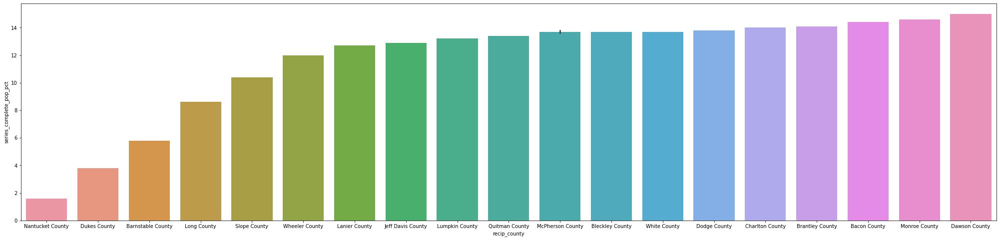

In [83]:
vac0 = vac[vac['series_complete_pop_pct'] > 0]
vac_least = vac0.sort_values(by='series_complete_pop_pct', ascending=True).head(20)

plt.figure(figsize = (35,8))

ax = sns.barplot(x = "recip_county", 
                 y = "series_complete_pop_pct",
                data = vac_least)

In [87]:
vac[vac['series_complete_pop_pct'] == 0]

,fips,recip_county,recip_state,series_complete_pop_pct,series_complete_yes,series_complete_12plus,series_complete_12pluspop_pct,series_complete_18plus,series_complete_18pluspop_pct,series_complete_65plus,series_complete_65pluspop_pct,completeness_pct,administered_dose1_recip,administered_dose1_pop_pct,administered_dose1_recip_12plus,administered_dose1_recip_12pluspop_pct,administered_dose1_recip_18plus,administered_dose1_recip_18pluspop_pct,administered_dose1_recip_65plus,administered_dose1_recip_65pluspop_pct,svi_ctgy,series_complete_pop_pct_svi,series_complete_12pluspop_pct_svi,series_complete_18pluspop_pct_svi,series_complete_65pluspop_pct_svi,metro_status,series_complete_pop_pct_ur_equity,series_complete_12pluspop_pct_ur_equity,series_complete_18pluspop_pct_ur_equity,series_complete_65pluspop_pct_ur_equity,administered_dose1_recip_5plus,administered_dose1_recip_5pluspop_pct,series_complete_5plus,series_complete_5pluspop_pct
26,15009,Maui County,HI,0.0,0,0.0,0.0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,B,0.0,0.0,0.0,0.0,Metro,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
41,6063,Plumas County,CA,0.0,0,0.0,0.0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,B,0.0,0.0,0.0,0.0,Non-metro,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
108,51690,Martinsville city,VA,0.0,0,0.0,0.0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,D,0.0,0.0,0.0,0.0,Non-metro,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
168,15007,Kauai County,HI,0.0,0,0.0,0.0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,B,0.0,0.0,0.0,0.0,Non-metro,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
205,15003,Honolulu County,HI,0.0,0,0.0,0.0,0,0.0,0,0.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,B,0.0,0.0,0.0,0.0,Metro,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
265,51775,Salem city,VA,0.0,0,0.0,0.0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,B,0.0,0.0,0.0,0.0,Metro,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
384,6043,Mariposa County,CA,0.0,0,0.0,0.0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,C,0.0,0.0,0.0,0.0,Non-metro,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
505,51590,Danville city,VA,0.0,0,0.0,0.0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,D,0.0,0.0,0.0,0.0,Non-metro,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
586,51620,Franklin city,VA,0.0,0,0.0,0.0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,C,0.0,0.0,0.0,0.0,Non-metro,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
648,51580,Covington city,VA,0.0,0,0.0,0.0,0,0.0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,B,0.0,0.0,0.0,0.0,Non-metro,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
